In [195]:
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, Polygon
import numpy as np

data = pd.read_csv("../data/cases_train.csv")

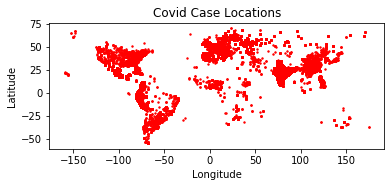

In [196]:
#COVID Case locations plot

#Create geodataframe
crs={'init':'epsg:4326'}
geometry=[Point(xy) for xy in zip(data["longitude"], data["latitude"])]
geodata=gpd.GeoDataFrame(data,crs=crs, geometry=geometry)

#Plot geodataframe
fig, ax = plt.subplots()
geodata.plot(ax=ax, color='red', markersize=2)
ax.set_title('Covid Case Locations', fontsize=12)
ax.set_xlabel('Longitude', fontsize=10)
ax.set_ylabel('Latitude', fontsize='medium')

#save plot
plt.savefig('../plots/plot1.png')

           Date  Count
0    2020-01-06      2
1    2020-01-12      1
2    2020-01-15      2
3    2020-01-18      2
4    2020-01-19      1
..          ...    ...
149  2020-06-12     46
150  2020-06-13     50
151  2020-06-14      9
152  2020-06-15      3
153  2020-06-16      9

[154 rows x 2 columns]


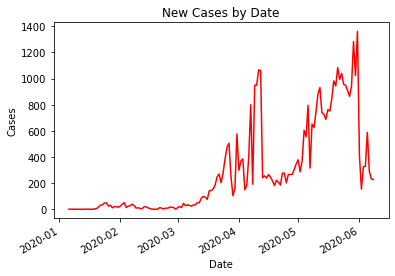

In [205]:
#Total new cases per day 

#Get cases per day
data['date_confirmation'] = pd.to_datetime(data['date_confirmation'], errors='coerce', dayfirst=True)
age_counts = only_ints.groupby(by=["date_confirmation"]).size()
date_counts.columns = ['Date','Count']

print(date_counts)

#Plot cases_per_day
fig, ax = plt.subplots()
ax = age_counts.plot(x='Date', y='Cases', color='red')
fig.autofmt_xdate()
ax.set_title('New Cases by Date', fontsize=12)
ax.set_xlabel('Date', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/plot2.png')


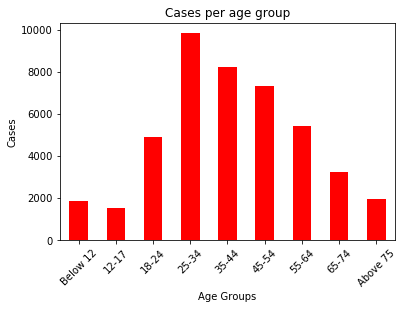

In [198]:
#Cases per age group

only_ints = data[data['age'].astype(str).str.isdigit()]
age_groups = pd.cut(only_ints.age.astype('int64'), bins=[0,11, 17, 24, 34, 44, 54, 64, 74, 99], labels=['Below 12','12-17','18-24','25-34', '35-44', '45-54', '55-64', '65-74', 'Above 75'])
only_ints.insert(5, "Age Group", age_groups)

age_counts = only_ints.groupby(by=["Age Group"]).size()
age_counts.columns = ['Age Group','Count']

#Plot cases_per_day
fig, ax = plt.subplots()
ax = age_counts.plot.bar(x='Age', y='Cases', color='red')
plt.xticks(rotation = 45) 
ax.set_title('Cases per age group', fontsize=12)
ax.set_xlabel('Age Groups', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/plot3.png')

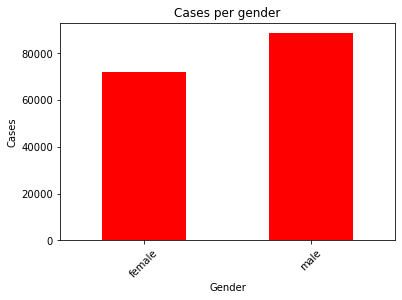

In [199]:
#Cases per gender

sex_counts = data.groupby(by=["sex"]).size()
sex_counts

#Plot cases_per_day
fig, ax = plt.subplots()
ax = sex_counts.plot.bar(x='Sex', y='Cases', color='red')
plt.xticks(rotation = 45) 
ax.set_title('Cases per gender', fontsize=12)
ax.set_xlabel('Gender', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/plot4.png')

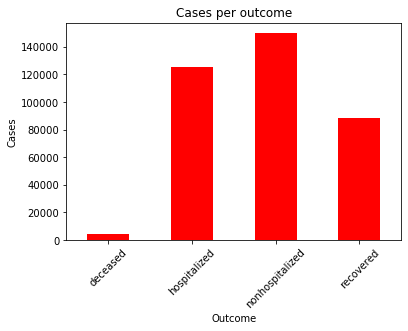

In [200]:
#Cases per Outcome

outcome_counts = data.groupby(by=["outcome"]).size()

#Plot cases_per_day
fig, ax = plt.subplots()
ax = outcome_counts.plot.bar(x='Outcome', y='Cases', color='red')
plt.xticks(rotation = 45) 
ax.set_title('Cases per outcome', fontsize=12)
ax.set_xlabel('Outcome', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/plot5.png')

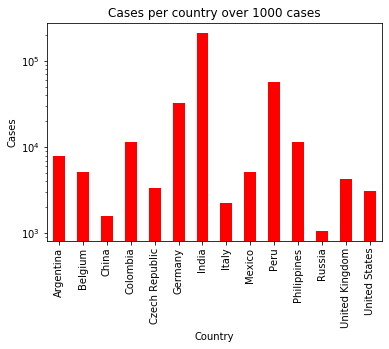

In [201]:
#Cases per Country over 1000 cases

country_counts = data.groupby(by=["country"]).size()
filter_small = country_counts[country_counts > 1000]

#Plot cases_per_day
fig, ax = plt.subplots()
ax = filter_small.plot.bar(x='Country', y='Cases', color='red')
plt.xticks(rotation = 90) 
plt.yscale("log")
ax.set_title('Cases per country over 1000 cases', fontsize=12)
ax.set_xlabel('Country', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/plot6.png')

In [202]:
# For every attribute print the number of missing values
print("Missing value counts for cases_train.csv\n")

print("AGE: " + str(data['age'].isnull().sum()))
print("SEX: " + str(data['sex'].isnull().sum()))
print("PROVINCE: " + str(data['province'].isnull().sum()))
print("COUNTRY: " + str(data['country'].isnull().sum()))
print("LATITUDE: " + str(data['latitude'].isnull().sum()))
print("DATE_CONFIRMATION: " + str(data['date_confirmation'].isnull().sum()))
print("ADDITIONAL_INFORMATION: " + str(data['additional_information'].isnull().sum()))
print("SOURCE: " + str(data['source'].isnull().sum()))
print("GEOMETRY: " + str(data['geometry'].isnull().sum()))




Missing value counts for cases_train.csv

AGE: 209265
SEX: 207084
PROVINCE: 4106
COUNTRY: 18
LATITUDE: 2
DATE_CONFIRMATION: 374
ADDITIONAL_INFORMATION: 344912
SOURCE: 128478
GEOMETRY: 0
